In [47]:
import os
import re
import cv2
import json

import numpy as np
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

from PIL import Image, ImageEnhance
from IPython.display import display

#### Setup

In [3]:
print("\n... BASIC DATA SETUP STARTING ...\n\n")

DATA_DIR = 'sartorius-cell-instance-segmentation'

print("\n... SET PATH INFORMATION ..\n")
LC_DIR = os.path.join(DATA_DIR, "LIVECell_dataset_2021")
LC_ANN_DIR = os.path.join(LC_DIR, "annotations")
LC_IMG_DIR = os.path.join(LC_DIR, "images")
TRAIN_DIR = os.path.join(DATA_DIR, "train")
TEST_DIR = os.path.join(DATA_DIR, "test")
SEMI_DIR = os.path.join(DATA_DIR, "train_semi_supervised")

print("\n... TRAIN DATAFRAME ...\n")

# FIX THE TRAIN DATAFRAME (GROUP THE RLEs TOGETHER)
TRAIN_CSV = os.path.join(DATA_DIR, "train.csv")
train_df = pd.read_csv(TRAIN_CSV)
display(train_df)

print("\n... SS DATAFRAME ..\n")
SS_CSV = os.path.join(DATA_DIR, "sample_submission.csv")
ss_df = pd.read_csv(SS_CSV)
ss_df["img_path"] = ss_df["id"].apply(lambda x: os.path.join(TEST_DIR, x+".png")) # Capture Image Path As Well
display(ss_df)

CELL_TYPES = list(train_df.cell_type.unique())
FIRST_SHSY5Y_IDX = 0
FIRST_ASTRO_IDX  = 1
FIRST_CORT_IDX   = 2

# This is required for plotting so that the smaller distributions get plotted on top
ARB_SORT_MAP = {"astro":0, "shsy5y":1, "cort":2}

print("\n... CELL TYPES ..")
for x in CELL_TYPES: print(f"\t--> {x}")
    
print("\n\n... BASIC DATA SETUP FINISHING ...\n")


... BASIC DATA SETUP STARTING ...



... SET PATH INFORMATION ..


... TRAIN DATAFRAME ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta
0,0030fd0e6378,118145 6 118849 7 119553 8 120257 8 120961 9 1...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00
1,0030fd0e6378,189036 1 189739 3 190441 6 191144 7 191848 8 1...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00
2,0030fd0e6378,173567 3 174270 5 174974 5 175678 6 176382 7 1...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00
3,0030fd0e6378,196723 4 197427 6 198130 7 198834 8 199538 8 2...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00
4,0030fd0e6378,167818 3 168522 5 169225 7 169928 8 170632 9 1...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00
...,...,...,...,...,...,...,...,...,...
73580,ffdb3cc02eef,3610 3 4311 7 5014 9 5717 11 6420 13 7123 15 7...,704,520,cort,11h59m00s,2020-11-01,cort[debris]_D9-3_Vessel-384_Ph_4,0 days 11:59:00
73581,ffdb3cc02eef,341585 2 342287 5 342988 10 343690 13 344394 1...,704,520,cort,11h59m00s,2020-11-01,cort[debris]_D9-3_Vessel-384_Ph_4,0 days 11:59:00
73582,ffdb3cc02eef,47788 3 48490 7 49192 11 49896 13 50599 14 513...,704,520,cort,11h59m00s,2020-11-01,cort[debris]_D9-3_Vessel-384_Ph_4,0 days 11:59:00
73583,ffdb3cc02eef,333290 1 333993 2 334696 4 335399 5 336102 6 3...,704,520,cort,11h59m00s,2020-11-01,cort[debris]_D9-3_Vessel-384_Ph_4,0 days 11:59:00



... SS DATAFRAME ..



,id,predicted,img_path
0,7ae19de7bc2a,NaN,sartorius-cell-instance-segmentation/test/7ae1...
1,d48ec7815252,NaN,sartorius-cell-instance-segmentation/test/d48e...
2,d8bfd1dafdc4,NaN,sartorius-cell-instance-segmentation/test/d8bf...



... CELL TYPES ..
	--> shsy5y
	--> astro
	--> cort


... BASIC DATA SETUP FINISHING ...



#### Utils

In [14]:
# ref: https://www.kaggle.com/paulorzp/run-length-encode-and-decode
def rle_decode(mask_rle, shape):
    '''
        mask_rle: run-length as string formated (start length)
        shape: (height,width) of array to return 
        Returns numpy array, 1 - mask, 0 - background
    '''
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape(shape)  # Needed to align to RLE direction


# ref.: https://www.kaggle.com/stainsby/fast-tested-rle
def rle_encode(img):
    '''
        img: numpy array, 1 - mask, 0 - background
        Returns run length as string formated
    '''
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)


def flatten_l_o_l(nested_list):
    """ Flatten a list of lists """
    return [item for sublist in nested_list for item in sublist]


def load_json_to_dict(json_path):
    """ tbd """
    with open(json_path) as json_file:
        data = json.load(json_file)
    return data

#### Data preparation

In [6]:
# Aggregate under training 
train_df["img_path"] = train_df["id"].apply(lambda x: os.path.join(TRAIN_DIR, x+".png")) # Capture Image Path As Well
tmp_df = train_df.drop_duplicates(subset=["id", "img_path"]).reset_index(drop=True)
tmp_df["annotation"] = train_df.groupby("id")["annotation"].agg(list).reset_index(drop=True)
train_df = tmp_df.copy()
display(train_df)

,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
0,0030fd0e6378,[118145 6 118849 7 119553 8 120257 8 120961 9 ...,704,520,shsy5y,11h30m00s,2019-06-16,shsy5y[diff]_E10-4_Vessel-714_Ph_3,0 days 11:30:00,sartorius-cell-instance-segmentation/train/003...
1,0140b3c8f445,[32499 3 33201 7 33902 9 34604 10 35306 11 360...,704,520,astro,09h00m00s,2020-09-13,astros[cereb]_F8-3_Vessel-361_Ph_4,0 days 09:00:00,sartorius-cell-instance-segmentation/train/014...
2,01ae5a43a2ab,[241026 3 241726 9 242427 13 243130 14 243834 ...,704,520,cort,13h30m00s,2020-11-04,cort[oka-high]_B5-1_Vessel-377_Ph_1,0 days 13:30:00,sartorius-cell-instance-segmentation/train/01a...
3,026b3c2c4b32,[170753 5 171454 12 172158 13 172862 13 173565...,704,520,cort,19h30m00s,2020-11-04,cort[oka-low]_H6-2_Vessel-377_Ph_2,0 days 19:30:00,sartorius-cell-instance-segmentation/train/026...
4,029e5b3b89c7,[139142 7 139845 10 140548 13 141251 15 141955...,704,520,cort,13h30m00s,2020-10-27,cort[pre-treat]_B8-2_Vessel-377_Ph_2,0 days 13:30:00,sartorius-cell-instance-segmentation/train/029...
...,...,...,...,...,...,...,...,...,...,...
601,fd98d82784a1,[335979 1 336681 3 337385 3 338088 3 338792 3 ...,704,520,astro,13h00m00s,2020-09-14,astro[hippo]_G1-4_Vessel-361_Ph_3,0 days 13:00:00,sartorius-cell-instance-segmentation/train/fd9...
602,fe33dfcf4ebd,[165826 7 166526 14 167199 45 167901 46 168603...,704,520,astro,13h00m00s,2020-09-15,astro[hippo]_F2-4_Vessel-361_Ph_1,0 days 13:00:00,sartorius-cell-instance-segmentation/train/fe3...
603,fe3e30f849f4,[343210 3 343912 4 344610 9 345312 10 346014 1...,704,520,shsy5y,11h30m00s,2019-06-15,shsy5y[diff]_D10-4_Vessel-714_Ph_3,0 days 11:30:00,sartorius-cell-instance-segmentation/train/fe3...
604,ffc2ead3e8cc,[252827 1 253531 3 254235 5 254940 5 255644 7 ...,704,520,astro,09h00m00s,2020-09-13,astros[cereb]_F11-4_Vessel-361_Ph_1,0 days 09:00:00,sartorius-cell-instance-segmentation/train/ffc...


In [39]:
def get_img_and_mask(img_path, annotation, width, height, mask_only=False, binary_mask=False):
    """ Capture the relevant image array as well as the image mask """
    img_mask = np.zeros((height, width), dtype=np.uint8)
    for i, annot in enumerate(annotation): 
        fill_value = 1 if binary_mask else i
        img_mask = np.where(rle_decode(annot, (height, width))!=0, fill_value, img_mask)
    
    # Early Exit
    if mask_only:
        return img_mask
    
    # Else Return images
    img = cv2.imread(img_path)[..., ::-1]
    return img[..., 0], img_mask


def plot_img_and_mask(img, mask, bboxes=None, invert_img=True, boost_contrast=True):
    """ Function to take an image and the corresponding mask and plot
    
    Args:
        img (np.arr): 1 channel np arr representing the image of cellular structures
        mask (np.arr): 1 channel np arr representing the instance masks (incrementing by one)
        bboxes (list of tuples, optional): (tl, br) coordinates of enclosing bboxes
        invert_img (bool, optional): Whether or not to invert the base image
        boost_contrast (bool, optional): Whether or not to boost contrast of the base image
        
    Returns:
        None; Plots the two arrays and overlays them to create a merged image
    """

    plt.figure(figsize=(20,10))
    
    plt.subplot(1,3,1)
    _img = np.tile(np.expand_dims(img, axis=-1), 3)
    
    # Flip black-->white ... white-->black
    if invert_img:
        _img = _img.max()-_img
    
    if boost_contrast:
        _img = np.asarray(ImageEnhance.Contrast(Image.fromarray(_img)).enhance(16))
    
    if bboxes:
        for i, bbox in enumerate(bboxes):
            mask = cv2.rectangle(mask, bbox[0], bbox[1], (i+1, 0, 0), thickness=2)
    
    plt.imshow(_img)
    plt.axis(False)
    plt.title("Cell Image", fontweight="bold")


    plt.subplot(1,3,2)
    _mask = np.zeros_like(_img)
    _mask[..., 0] = mask
    plt.imshow(mask, cmap="inferno")
    plt.axis(False)
    plt.title("Instance Segmentation Mask", fontweight="bold")
    
    merged = cv2.addWeighted(_img, 0.75, np.clip(_mask, 0, 1)*255, 0.25, 0.0,)
    plt.subplot(1,3,3)
    plt.imshow(merged)
    plt.axis(False)
    plt.title("Cell Image w/ Instance Segmentation Mask Overlay", fontweight="bold")
    
    plt.tight_layout()
    plt.show()






... RELEVANT DATAFRAME ROW - INDEX=2 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
2,01ae5a43a2ab,[241026 3 241726 9 242427 13 243130 14 243834 ...,704,520,cort,13h30m00s,2020-11-04,cort[oka-high]_B5-1_Vessel-377_Ph_1,0 days 13:30:00,sartorius-cell-instance-segmentation/train/01a...


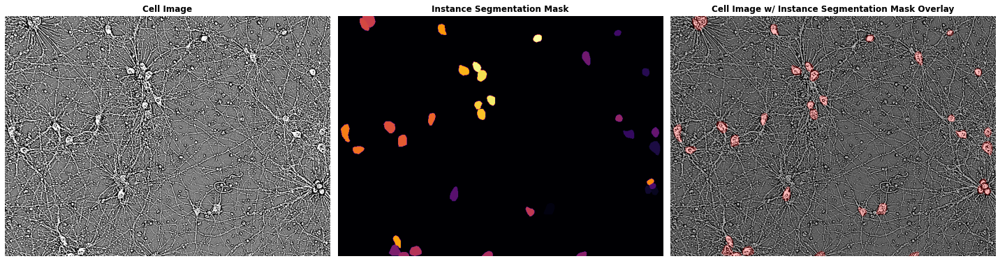





... RELEVANT DATAFRAME ROW - INDEX=10 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
10,049f02e0f764,[312064 4 312767 6 313469 8 314172 10 314876 1...,704,520,cort,07h30m00s,2020-11-06,cort[6-OHDA]_G2-3_Vessel-377_Ph_3,0 days 07:30:00,sartorius-cell-instance-segmentation/train/049...


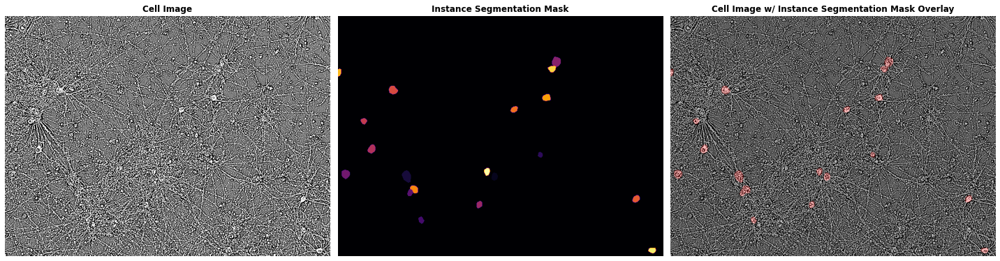





... RELEVANT DATAFRAME ROW - INDEX=18 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
18,083b178bb184,[230265 7 230968 9 231671 11 232374 13 233078 ...,704,520,cort,19h30m00s,2020-11-04,cort[6-OHDA]_B1-3_Vessel-377_Ph_4,0 days 19:30:00,sartorius-cell-instance-segmentation/train/083...


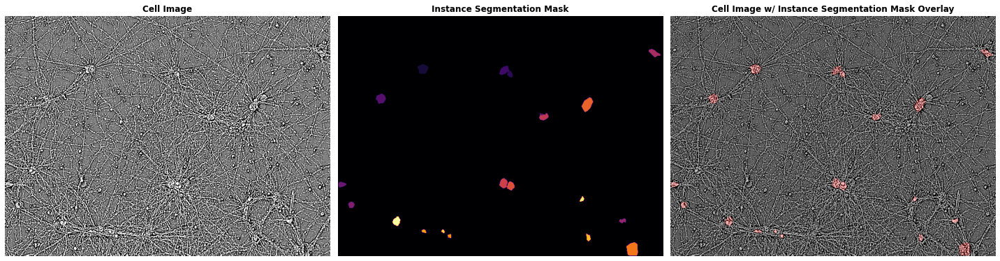





... RELEVANT DATAFRAME ROW - INDEX=26 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
26,0cfdeeb0dded,[352146 3 352849 7 353552 9 354255 10 354959 1...,704,520,cort,13h30m00s,2020-10-27,cort[pre-treat]_A4-2_Vessel-377_Ph_3,0 days 13:30:00,sartorius-cell-instance-segmentation/train/0cf...


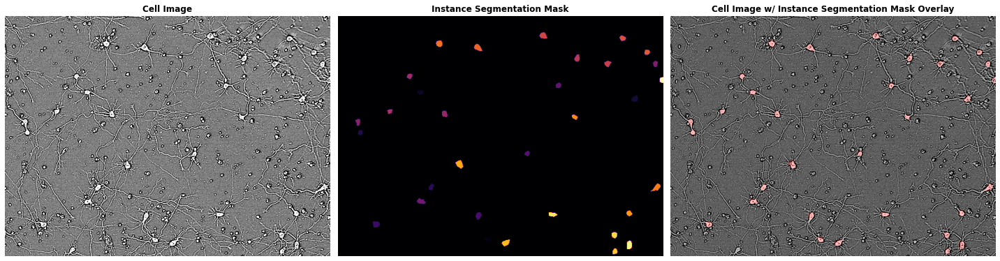





... RELEVANT DATAFRAME ROW - INDEX=34 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
34,0f2a46026693,[192272 3 192973 7 193676 9 194379 11 195082 1...,704,520,cort,13h30m00s,2020-10-27,cort[pre-treat]_B8-4_Vessel-377_Ph_4,0 days 13:30:00,sartorius-cell-instance-segmentation/train/0f2...


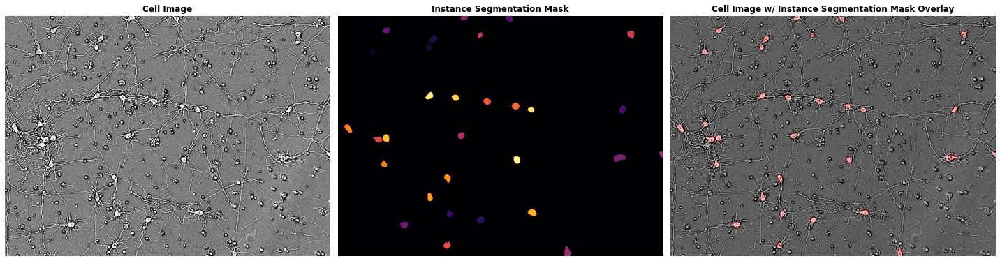





... RELEVANT DATAFRAME ROW - INDEX=42 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
42,13325f865bb0,[195920 2 196623 5 197327 6 198030 7 198733 7 ...,704,520,astro,09h00m00s,2020-09-14,astros[cereb]_G12-2_Vessel-361_Ph_4,0 days 09:00:00,sartorius-cell-instance-segmentation/train/133...


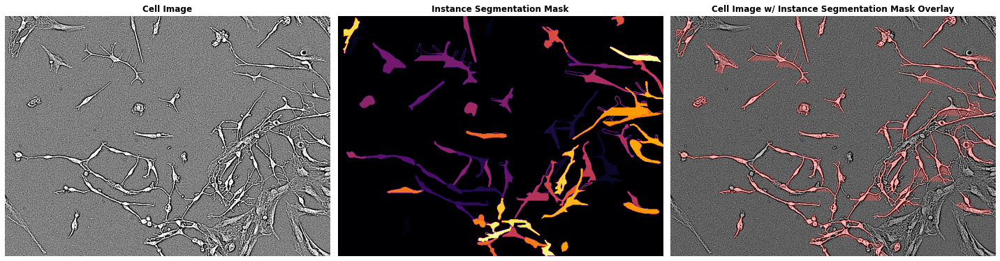





... RELEVANT DATAFRAME ROW - INDEX=50 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
50,172334437c88,[27716 8 28417 12 29118 15 29820 18 30523 19 3...,704,520,cort,13h30m00s,2020-11-04,cort[oka-high]_B6-1_Vessel-377_Ph_1,0 days 13:30:00,sartorius-cell-instance-segmentation/train/172...


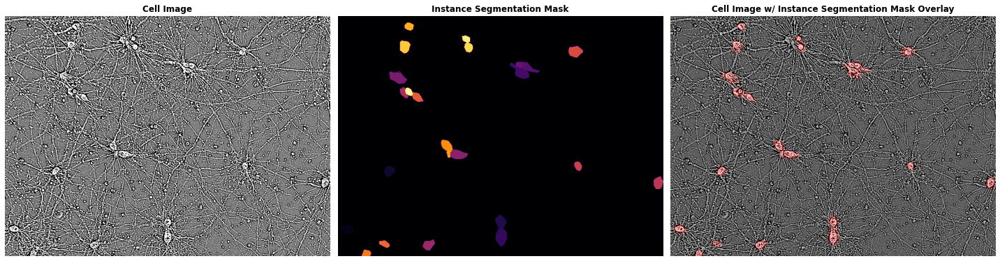





... RELEVANT DATAFRAME ROW - INDEX=58 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
58,1974fbb27dcf,[160570 2 161272 5 161974 7 162678 7 163382 8 ...,704,520,shsy5y,11h30m00s,2019-06-15,shsy5y[diff]_D9-2_Vessel-714_Ph_3,0 days 11:30:00,sartorius-cell-instance-segmentation/train/197...


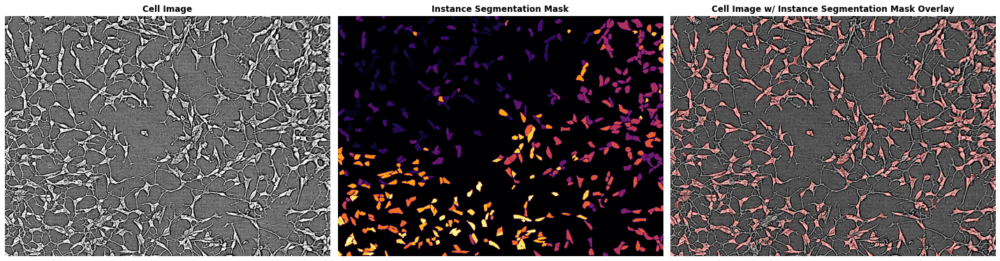





... RELEVANT DATAFRAME ROW - INDEX=66 ...



,id,annotation,width,height,cell_type,plate_time,sample_date,sample_id,elapsed_timedelta,img_path
66,1cc3b45e0399,[348250 3 348953 9 349656 13 350360 14 351063 ...,704,520,shsy5y,11h30m00s,2019-06-15,shsy5y[diff]_D10-4_Vessel-714_Ph_1,0 days 11:30:00,sartorius-cell-instance-segmentation/train/1cc...


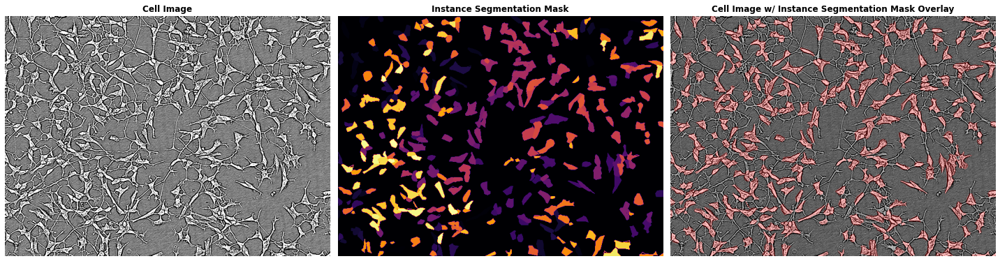

In [16]:
for i in range(2, 70, 8):
    print(f"\n\n\n\n... RELEVANT DATAFRAME ROW - INDEX={i} ...\n")
    display(train_df.iloc[i:i+1])
    img, msk = get_img_and_mask(**train_df[["img_path", "annotation", "width", "height"]].iloc[i].to_dict())
    plot_img_and_mask(img, msk)



... WIDTH VALUE COUNTS ...
	--> There are 606 images with WIDTH=704


... HEIGHT VALUE COUNTS ...
	--> There are 606 images with HEIGHT=520


... AREA COUNTS ...
	--> There are 606 images with AREA=366080


... NOTE: ALL THE IMAGES ARE THE SAME SIZE ...



... PLATE TIME VALUE COUNTS ...
	--> There are 184 images with PLATE_TIME=13h30m00s
	--> There are 155 images with PLATE_TIME=11h30m00s
	--> There are 72 images with PLATE_TIME=09h00m00s
	--> There are 64 images with PLATE_TIME=19h30m00s
	--> There are 59 images with PLATE_TIME=13h00m00s
	--> There are 32 images with PLATE_TIME=07h30m00s
	--> There are 24 images with PLATE_TIME=01h30m00s
	--> There are 16 images with PLATE_TIME=11h59m00s




... SAMPLE DATE VALUE COUNTS ...
	--> There are 68 images with SAMPLE_DATE=2020-11-04
	--> There are 64 images with SAMPLE_DATE=2020-11-05
	--> There are 52 images with SAMPLE_DATE=2019-06-16
	--> There are 52 images with SAMPLE_DATE=2019-06-14
	--> There are 51 images with SAMPLE_DATE=2019-06-15
	--> There are 48 images with SAMPLE_DATE=2020-11-03
	--> There are 46 images with SAMPLE_DATE=2020-09-14
	--> There are 24 images with SAMPLE_DATE=2020-09-12
	--> There are 24 images with SAMPLE_DATE=2020-09-13
	--> There are 24 images with SAMPLE_DATE=2020-10-30
	--> There are 24 images with SAMPLE_DATE=2020-11-01
	--> There are 24 images with SAMPLE_DATE=2020-10-26
	--> There are 24 images with SAMPLE_DATE=2020-11-07
	--> There are 22 images with SAMPLE_DATE=2020-09-15
	--> There are 16 images with SAMPLE_DATE=2020-10-29
	--> There are 16 images with SAMPLE_DATE=2020-10-27
	--> There are 15 images with SAMPLE_DATE=2020-09-16
	--> There are 12 images with SAMPLE_DATE=2020-11-06




... ELAPSED TIME DELTA VALUE COUNTS ...
	--> There are 184 images with SAMPLE_DATE=0 days 13:30:00
	--> There are 155 images with SAMPLE_DATE=0 days 11:30:00
	--> There are 72 images with SAMPLE_DATE=0 days 09:00:00
	--> There are 64 images with SAMPLE_DATE=0 days 19:30:00
	--> There are 59 images with SAMPLE_DATE=0 days 13:00:00
	--> There are 32 images with SAMPLE_DATE=0 days 07:30:00
	--> There are 24 images with SAMPLE_DATE=0 days 01:30:00
	--> There are 16 images with SAMPLE_DATE=0 days 11:59:00




... SAMPLE ID VALUE COUNTS (>1) ...
	--> There are 358 SAMPLE_IDs with more than one image

	--> There are 4 images with SAMPLE_ID=cort[density]_A10-3_Vessel-376_Ph_4
	--> There are 4 images with SAMPLE_ID=cort[pre-treat]_A4-2_Vessel-377_Ph_2
	--> There are 4 images with SAMPLE_ID=cort[pre-treat]_B8-2_Vessel-377_Ph_1
	--> There are 4 images with SAMPLE_ID=cort[6-OHDA]_B1-1_Vessel-377_Ph_3
	--> There are 3 images with SAMPLE_ID=cort[oka-high]_B5-4_Vessel-377_Ph_4
	--> There are 3 images with SAMPLE_ID=cort[density]_B11-2_Vessel-376_Ph_4
	--> There are 3 images with SAMPLE_ID=shsy5y[diff]_E8-4_Vessel-714_Ph_2
	--> There are 3 images with SAMPLE_ID=cort[oka-low]_H6-4_Vessel-377_Ph_1
	--> There are 3 images with SAMPLE_ID=cort[pre-treat]_A4-4_Vessel-377_Ph_1
	--> There are 3 images with SAMPLE_ID=cort[pre-treat]_B8-4_Vessel-377_Ph_2
	--> There are 3 images with SAMPLE_ID=cort[pre-treat]_A4-4_Vessel-377_Ph_3
	--> There are 3 images with SAMPLE_ID=cort[density]_C11-4_Vessel-376_Ph_2
	--> T



... CELL TYPE VALUE COUNTS ...
	--> There are 320 images with CELL_TYPE=cort
	--> There are 155 images with CELL_TYPE=shsy5y
	--> There are 131 images with CELL_TYPE=astro




... SHOWING THREE EXAMPLES OF CELL TYPE SHSY5Y ...



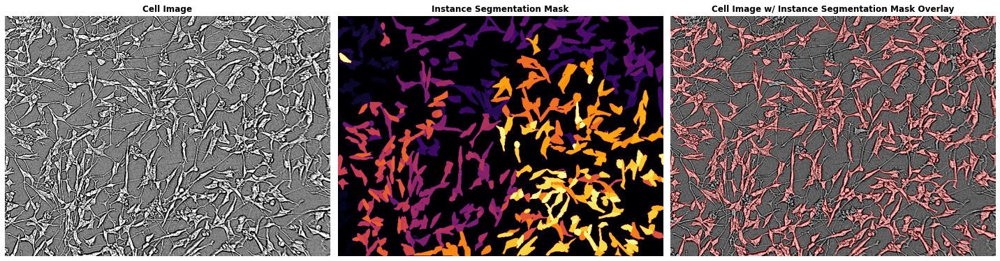

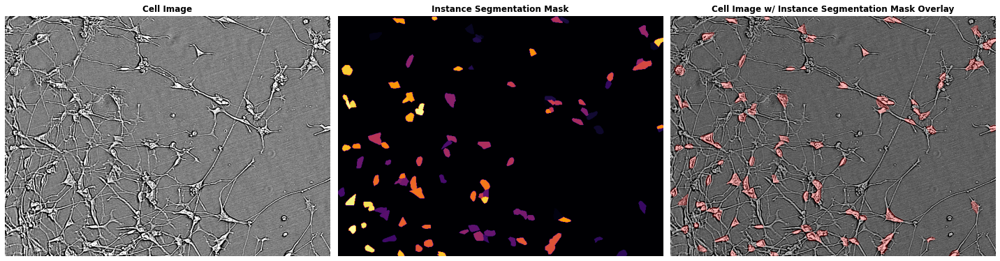

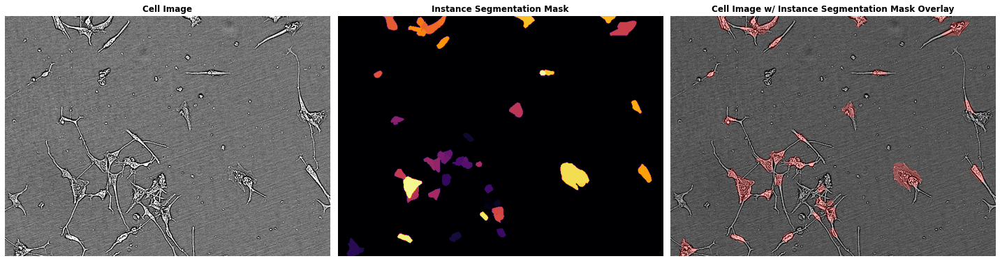



... SHOWING THREE EXAMPLES OF CELL TYPE ASTRO ...



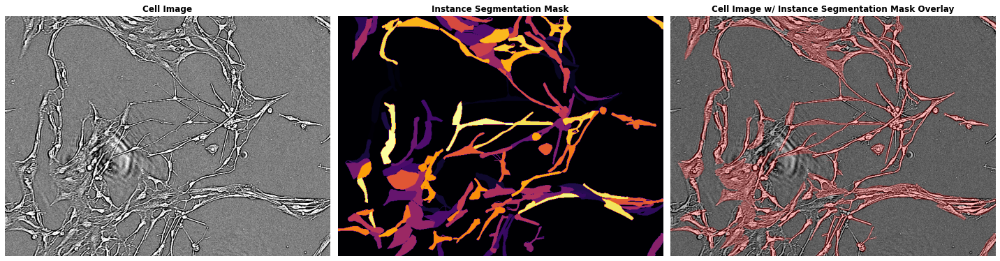

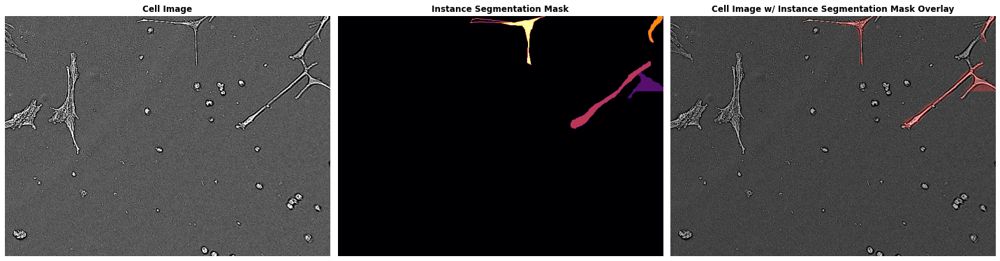

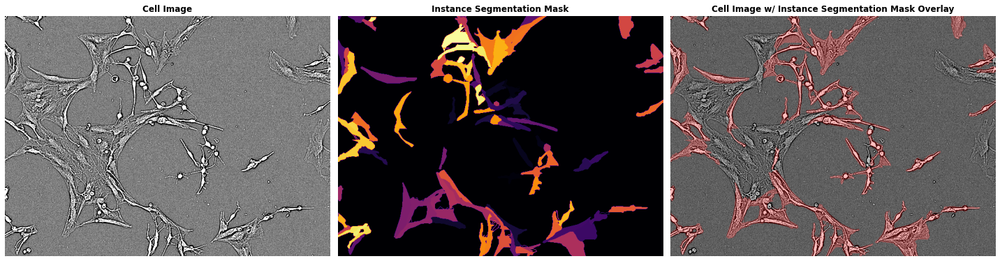



... SHOWING THREE EXAMPLES OF CELL TYPE CORT ...



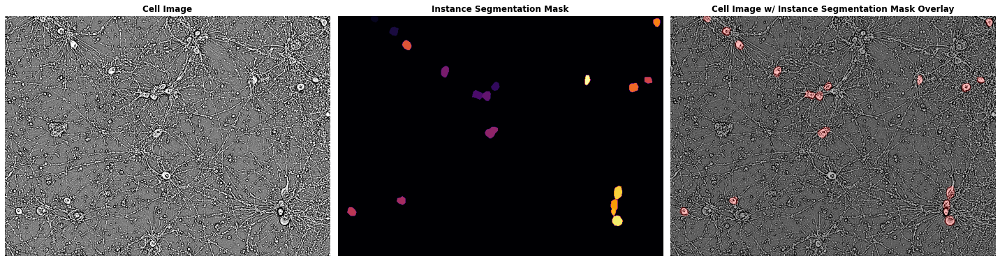

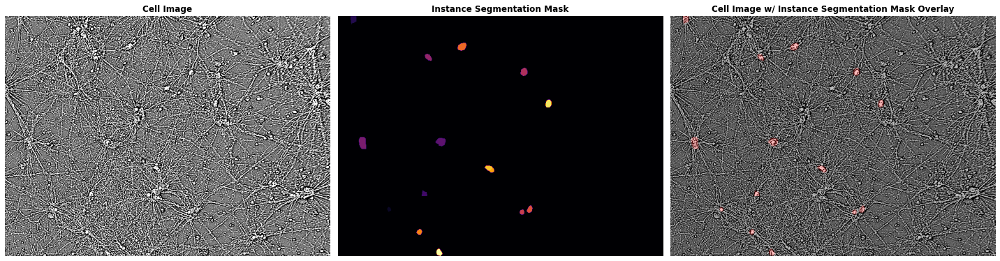

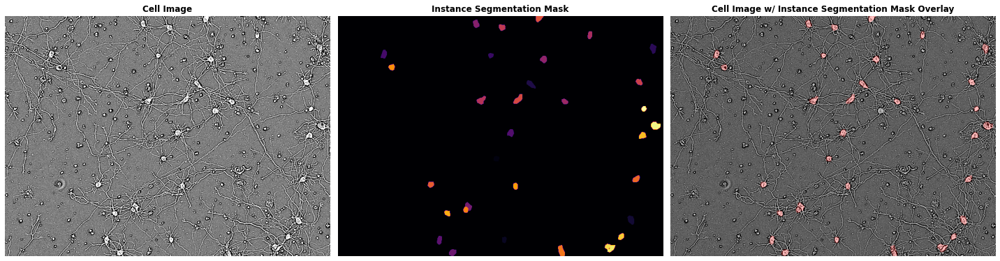

In [18]:
print("\n\n... WIDTH VALUE COUNTS ...")
for k,v in train_df.width.value_counts().items():
    print(f"\t--> There are {v} images with WIDTH={k}")

print("\n\n... HEIGHT VALUE COUNTS ...")
for k,v in train_df.height.value_counts().items():
    print(f"\t--> There are {v} images with HEIGHT={k}")

print("\n\n... AREA COUNTS ...")
for k,v in (train_df.width*train_df.height).value_counts().items():
    print(f"\t--> There are {v} images with AREA={k}")

print("\n\n... NOTE: ALL THE IMAGES ARE THE SAME SIZE ...\n")

print("\n\n... PLATE TIME VALUE COUNTS ...")
for k,v in train_df.plate_time.value_counts().items():
    print(f"\t--> There are {v} images with PLATE_TIME={k}")
fig = px.histogram(train_df, x="plate_time", color="cell_type", title="<b>Plate Time Histogram</b>")
fig.show()

print("\n\n... SAMPLE DATE VALUE COUNTS ...")
for k,v in train_df.sample_date.value_counts().items():
    print(f"\t--> There are {v} images with SAMPLE_DATE={k}")
fig = px.histogram(train_df, train_df.sample_date.apply(lambda x: x.replace("-", "_")), color="cell_type", title="<b>Sample Date Value Histogram</b>")
fig.show()

print("\n\n... ELAPSED TIME DELTA VALUE COUNTS ...")
for k,v in train_df.elapsed_timedelta.value_counts().items():
    print(f"\t--> There are {v} images with SAMPLE_DATE={k}")
fig = px.histogram(train_df, "elapsed_timedelta", color="cell_type", title="<b>Elapsed Time Delta Value Histogram</b>")
fig.show()

print("\n\n... SAMPLE ID VALUE COUNTS (>1) ...")
print(f"\t--> There are {len(train_df[train_df.sample_id.isin([x for x,v in train_df.sample_id.value_counts().items() if v>1])])} SAMPLE_IDs with more than one image\n")
for k,v in train_df[train_df.sample_id.isin([x for x,v in train_df.sample_id.value_counts().items() if v>1])].reset_index()["sample_id"].value_counts().items():
    print(f"\t--> There are {v} images with SAMPLE_ID={k}")
fig = px.histogram(train_df[train_df.sample_id.isin([x for x,v in train_df.sample_id.value_counts().items() if v>1])].reset_index(), "sample_id", color="cell_type", title="<b>Sample ID Value Histogram</b>")
fig.show()


print("\n\n... CELL TYPE VALUE COUNTS ...")
for k,v in train_df.cell_type.value_counts().items():
    print(f"\t--> There are {v} images with CELL_TYPE={k}")
    
fig = px.histogram(train_df, x="cell_type", title="<b>Cell Type Histogram</b>")
fig.show()

for ct in CELL_TYPES:
    print(f"\n\n... SHOWING THREE EXAMPLES OF CELL TYPE {ct.upper()} ...\n")
    for i in range(3):
        img, msk = get_img_and_mask(**train_df[train_df.cell_type==ct][["img_path", "annotation", "width", "height"]].sample(3).reset_index(drop=True).iloc[i].to_dict())
        plot_img_and_mask(img, msk)

**Some comments.** Cell type cort contains two times more data than other classes - class imbalance. It may be considered in loss function. Another think to mention is that inputs the same as annotations differs for each class. Some guidance about input class could be useful. 

#### LiveCELL data (in progress)

In [21]:
DEFER = True

if not DEFER:
    LC_CELL_TYPES = os.listdir(os.path.join(LC_ANN_DIR, "LIVECell_single_cells"))

    print("\n... LOADING TRAIN COCO JSON ...\n")
    LC_COCO_TRAIN = os.path.join(LC_ANN_DIR, "LIVECell", "livecell_coco_train.json")

    print("\n... LOADING VALIDATION COCO JSON ...\n")
    LC_COCO_VAL = os.path.join(LC_ANN_DIR, "LIVECell", "livecell_coco_val.json")

    print("\n... LOADING TEST COCO JSON ...\n")
    LC_COCO_TEST = os.path.join(LC_ANN_DIR, "LIVECell", "livecell_coco_test.json")


    LC_SC_TRAIN = {
        lc_ct:os.path.join(LC_ANN_DIR, "LIVECell_single_cells", lc_ct, f"livecell_{lc_ct}_train.json") \
        for lc_ct in LC_CELL_TYPES
    }
    LC_SC_VAL = {
        lc_ct:os.path.join(LC_ANN_DIR, "LIVECell_single_cells", lc_ct, f"livecell_{lc_ct}_val.json") \
        for lc_ct in LC_CELL_TYPES
    }
    LC_SC_TEST = {
        lc_ct:os.path.join(LC_ANN_DIR, "LIVECell_single_cells", lc_ct, f"livecell_{lc_ct}_test.json") \
        for lc_ct in LC_CELL_TYPES
    }

    print(LC_SC_TRAIN)
    print(LC_SC_VAL)
    print(LC_SC_TEST)

#### Semi-supervised data

In [22]:
semi_df = pd.DataFrame()

semi_df["cell_type"] = [x.split("[", 1)[0] for x in os.listdir(SEMI_DIR)]
semi_df["compound"] = [x.split("]", 1)[0].split("[", 1)[-1] for x in os.listdir(SEMI_DIR)]
semi_df["img_path"] = [os.path.join(SEMI_DIR, x) for x in os.listdir(SEMI_DIR)]

fig = px.histogram(semi_df, "cell_type", color="compound")
fig.show()

fig = px.histogram(semi_df, "compound", color="cell_type")
fig.show()

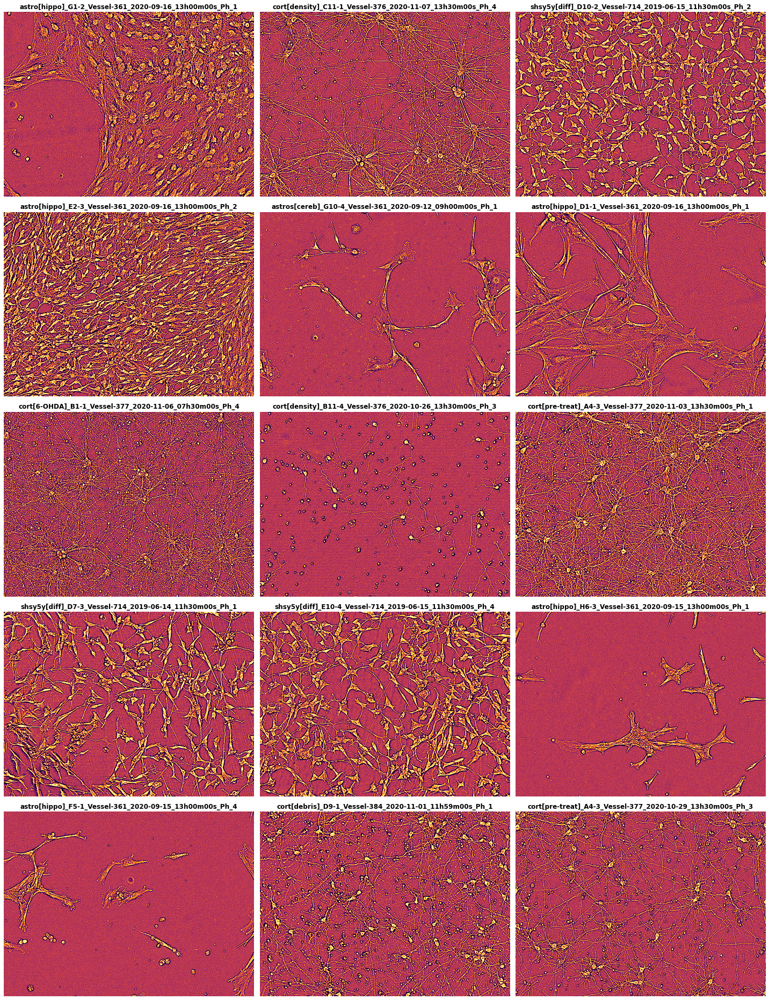

In [23]:
plt.figure(figsize=(20,26))
for i, img_path in zip(range(15), semi_df.img_path.to_list()):
    plt.subplot(5,3,i+1)
    plt.imshow((255-np.asarray(ImageEnhance.Contrast(Image.open(img_path)).enhance(16))), cmap="inferno")
    plt.axis(False)
    plt.title(img_path.rsplit("/", 1)[-1].rsplit(".", 1)[0], fontweight="bold")
    
plt.tight_layout()
plt.show()

In [24]:
# https://github.com/PyImageSearch/imutils/blob/master/imutils/convenience.py
def grab_contours(cnts):
    # if the length the contours tuple returned by cv2.findContours
    # is '2' then we are using either OpenCV v2.4, v4-beta, or
    # v4-official
    if len(cnts) == 2:
        cnts = cnts[0]

    # if the length of the contours tuple is '3' then we are using
    # either OpenCV v3, v4-pre, or v4-alpha
    elif len(cnts) == 3:
        cnts = cnts[1]

    # otherwise OpenCV has changed their cv2.findContours return
    # signature yet again and I have no idea WTH is going on
    else:
        raise Exception(("Contours tuple must have length 2 or 3, "
            "otherwise OpenCV changed their cv2.findContours return "
            "signature yet again. Refer to OpenCV's documentation "
            "in that case"))

    # return the actual contours array
    return cnts


def get_contour_bbox(msk):
    """ Function to return the bounding box (tl, br) for a given mask """
    
    # Get contour(s) --> There should be only one
    cnts = cv2.findContours(msk.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    contour = grab_contours(cnts)
    
    if len(contour)==0:
        return None
    else:
        contour = contour[0]
    
    # Get extreme coordinates
    tl = (tuple(contour[contour[:, :, 0].argmin()][0])[0], 
          tuple(contour[contour[:, :, 1].argmin()][0])[1])
    br = (tuple(contour[contour[:, :, 0].argmax()][0])[0], 
          tuple(contour[contour[:, :, 1].argmax()][0])[1])
    return tl, br

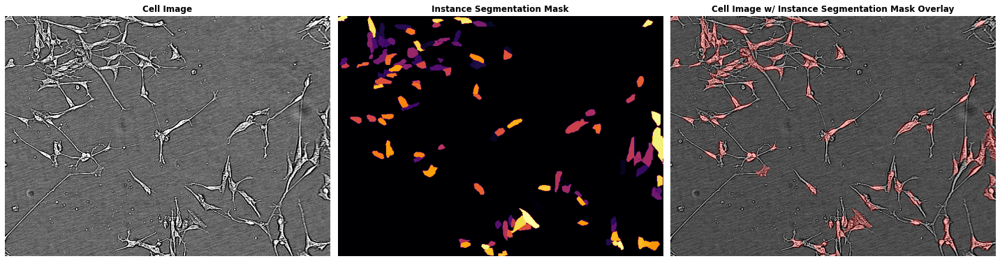

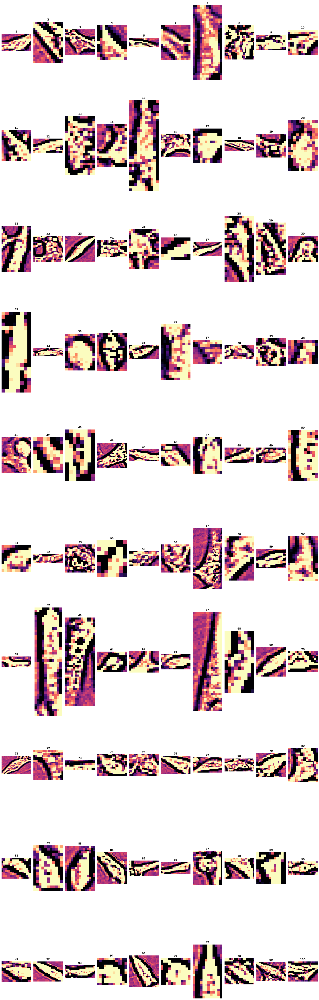

In [25]:
DEMO_IDX = 11
img, msk = get_img_and_mask(**train_df[["img_path", "annotation", "width", "height"]].iloc[DEMO_IDX].to_dict())
plot_img_and_mask(img, msk)

plt.figure(figsize=(20, min(80, msk.max()//2)))
for i in range(1, msk.max()+1):
    plt.subplot(10,10,i)
    tl, br = get_contour_bbox(np.where(msk==i, 1, 0).astype(np.uint8))
    plt.imshow(np.asarray(ImageEnhance.Contrast(Image.fromarray(255-img)).enhance(16))[tl[1]:br[1], tl[0]:br[0]], cmap="magma")
    plt.axis(False)
    plt.title(f"{i}", fontweight="bold")
    if i==100:
        break
    
plt.tight_layout()
plt.show()

In [69]:
def save_mask(img_path, mask):
    mask_path = re.sub('.png', '_mask.tif', img_path)
    Image.fromarray(mask).save(mask_path)


def extend_image_folder_w_masks(dataframe):
    for _, (path, annot, width, height) in dataframe[["img_path", "annotation", "width", "height"]].iterrows():
        mask = get_img_and_mask(path, annot, width, height, mask_only=True, binary_mask=True)
        save_mask(path, mask)

In [70]:
extend_image_folder_w_masks(train_df)

In [71]:
img_path = train_df['img_path'].iloc[0]
mask_path = re.sub('.png', '_mask.tif', img_path)

img = np.array(Image.open(img_path))
mask = np.array(Image.open(mask_path))

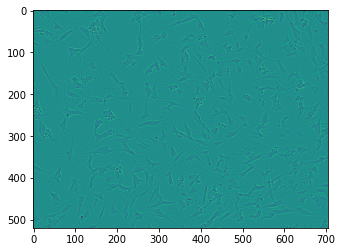

In [72]:
plt.imshow(img)

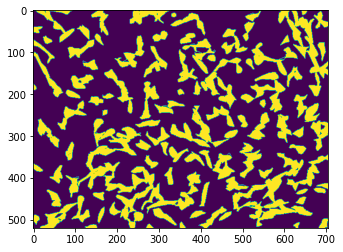

In [73]:
plt.imshow(mask)

In [5]:
from dataset import SartoriousDataset

In [4]:
dataset = SartoriousDataset(root_dir='sartorius-cell-instance-segmentation/train')

NameError: name 'SartoriousDataset' is not defined